<a href="https://colab.research.google.com/github/Neethu0207/Neethu/blob/main/Music.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SPOTIFY MUSIC RECOMMENDATION SYSTEM

**Importing necessary libraries**

In [1]:
import os
import numpy as np
import pandas as pd


import missingno
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
from scipy import stats
#import spotipy as sp

import warnings
warnings.filterwarnings("ignore")

**Loading Dataset**

In [2]:
df=pd.read_csv('/content/spotify.csv.zip')

In [3]:
df.head(2)

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991,['Mamie Smith'],0.598,168333,0.224,0,0cS0A1fUEUd1EW3FcF8AEI,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.634,1920
1,0.643,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0hbkKFIJm7Z05H8Zl9w30f,0.026400,5,0.0809,-7.261,0,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.950,1920


In [4]:
df.shape

(174389, 19)

In [5]:
df.dtypes

,0
acousticness,float64
artists,object
danceability,float64
duration_ms,int64
energy,float64
explicit,int64
id,object
instrumentalness,float64
key,int64
liveness,float64


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174389 entries, 0 to 174388
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   acousticness      174389 non-null  float64
 1   artists           174389 non-null  object 
 2   danceability      174389 non-null  float64
 3   duration_ms       174389 non-null  int64  
 4   energy            174389 non-null  float64
 5   explicit          174389 non-null  int64  
 6   id                174389 non-null  object 
 7   instrumentalness  174389 non-null  float64
 8   key               174389 non-null  int64  
 9   liveness          174389 non-null  float64
 10  loudness          174389 non-null  float64
 11  mode              174389 non-null  int64  
 12  name              174389 non-null  object 
 13  popularity        174389 non-null  int64  
 14  release_date      174389 non-null  object 
 15  speechiness       174389 non-null  float64
 16  tempo             17

**Data Preprocessing**

In [7]:
df.isnull().sum()

,0
acousticness,0
artists,0
danceability,0
duration_ms,0
energy,0
explicit,0
id,0
instrumentalness,0
key,0
liveness,0


**Descriptive Statistic**

In [8]:
df.describe()

,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,year
count,174389.000000,174389.000000,1.743890e+05,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000
mean,0.499228,0.536758,2.328100e+05,0.482721,0.068135,0.197252,5.205305,0.211123,-11.750865,0.702384,25.693381,0.105729,117.006500,0.524533,1977.061764
std,0.379936,0.176025,1.483958e+05,0.272685,0.251978,0.334574,3.518292,0.180493,5.691591,0.457211,21.872740,0.182260,30.254178,0.264477,26.907950
min,0.000000,0.000000,4.937000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1920.000000
25%,0.087700,0.414000,1.661330e+05,0.249000,0.000000,0.000000,2.000000,0.099200,-14.908000,0.000000,1.000000,0.035200,93.931000,0.311000,1955.000000
50%,0.517000,0.548000,2.057870e+05,0.465000,0.000000,0.000524,5.000000,0.138000,-10.836000,1.000000,25.000000,0.045500,115.816000,0.536000,1977.000000
75%,0.895000,0.669000,2.657200e+05,0.711000,0.000000,0.252000,8.000000,0.270000,-7.499000,1.000000,42.000000,0.076300,135.011000,0.743000,1999.000000
max,0.996000,0.988000,5.338302e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.971000,243.507000,1.000000,2021.000000


**Exploratory Data Analysis**

We will now vizualize our data, to understand, how music changed during the century.

100%|██████████| 13/13 [00:50<00:00,  3.91s/it]


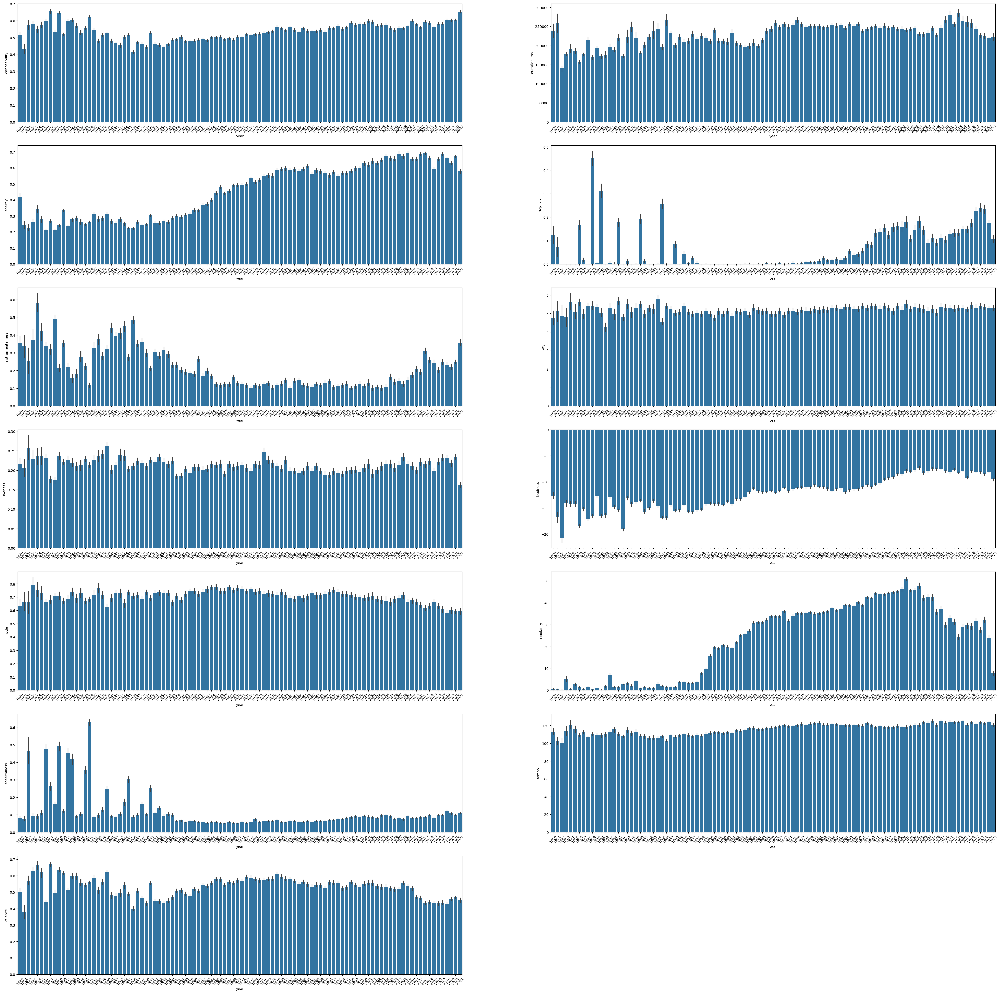

In [9]:
viz_df = df.drop(columns=['id', 'name', 'artists', 'release_date', 'year'])

import seaborn as sns # Import seaborn for barplot
from tqdm import tqdm # Import tqdm for progress bar

plt.figure(figsize=(50, 50))
for i in tqdm(np.arange(1, len(viz_df.columns))):
    plt.subplot(7, 2, i)
    sns.barplot(x=df.year,y=viz_df[viz_df.columns[i]])
    plt.xticks(rotation=45);
plt.show()

In [10]:
print(df.columns)

Index(['acousticness', 'artists', 'danceability', 'duration_ms', 'energy',
       'explicit', 'id', 'instrumentalness', 'key', 'liveness', 'loudness',
       'mode', 'name', 'popularity', 'release_date', 'speechiness', 'tempo',
       'valence', 'year'],
      dtype='object')


In [11]:

df['year'] = pd.Categorical(df['year'])
df['key'] = pd.Categorical(df['key'])
df['mode'] = pd.Categorical(df['mode'])

In [12]:
round(df.describe(include = 'all'),2)

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
count,174389.00,174389,174389.00,174389.00,174389.00,174389.00,174389,174389.00,174389.0,174389.00,174389.00,174389.0,174389,174389.00,174389,174389.00,174389.00,174389.00,174389.0
unique,NaN,36195,NaN,NaN,NaN,NaN,172230,NaN,12.0,NaN,NaN,2.0,137013,NaN,11043,NaN,NaN,NaN,102.0
top,NaN,['Tadeusz Dolega Mostowicz'],NaN,NaN,NaN,NaN,0UsmyJDsst2xhX1ZiFF3JW,NaN,0.0,NaN,NaN,1.0,White Christmas,NaN,1945,NaN,NaN,NaN,2020.0
freq,NaN,1281,NaN,NaN,NaN,NaN,9,NaN,21967.0,NaN,NaN,122488.0,103,NaN,1447,NaN,NaN,NaN,4294.0
mean,0.50,NaN,0.54,232810.03,0.48,0.07,NaN,0.20,NaN,0.21,-11.75,NaN,NaN,25.69,NaN,0.11,117.01,0.52,NaN
std,0.38,NaN,0.18,148395.80,0.27,0.25,NaN,0.33,NaN,0.18,5.69,NaN,NaN,21.87,NaN,0.18,30.25,0.26,NaN
min,0.00,NaN,0.00,4937.00,0.00,0.00,NaN,0.00,NaN,0.00,-60.00,NaN,NaN,0.00,NaN,0.00,0.00,0.00,NaN
25%,0.09,NaN,0.41,166133.00,0.25,0.00,NaN,0.00,NaN,0.10,-14.91,NaN,NaN,1.00,NaN,0.04,93.93,0.31,NaN
50%,0.52,NaN,0.55,205787.00,0.46,0.00,NaN,0.00,NaN,0.14,-10.84,NaN,NaN,25.00,NaN,0.05,115.82,0.54,NaN
75%,0.90,NaN,0.67,265720.00,0.71,0.00,NaN,0.25,NaN,0.27,-7.50,NaN,NaN,42.00,NaN,0.08,135.01,0.74,NaN


Loading dataset by genres

In [14]:
df_genre=pd.read_csv('/content/data_by_genres.csv')

In [15]:
df_genre.head(2)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.3616,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.1310,-16.854000,0.076817,120.285667,0.221750,52.500000,5


In [16]:
df_genre.size

41622

In [17]:
df_genre.info() #checking datatype of columns


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [18]:

#converting numeric to categorical
df_genre['genres'] = pd.Categorical(df_genre['genres'])
df_genre['key'] = pd.Categorical(df_genre['key'])
df_genre['mode'] = pd.Categorical(df_genre['mode'])



In [19]:
round(df_genre.describe(include = 'all'),2)


,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,2973.0,2973,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.0
unique,2.0,2973,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0
top,1.0,zydeco,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
freq,2477.0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,694.0
mean,NaN,NaN,0.40,0.54,251720.85,0.56,0.21,0.19,-10.51,0.08,119.02,0.49,39.92,NaN
std,NaN,NaN,0.32,0.15,94656.86,0.23,0.27,0.09,5.37,0.08,17.47,0.20,16.75,NaN
min,NaN,NaN,0.00,0.06,30946.00,0.00,0.00,0.02,-41.82,0.02,47.14,0.00,0.00,NaN
25%,NaN,NaN,0.12,0.44,206378.85,0.40,0.00,0.14,-12.43,0.04,109.20,0.35,32.49,NaN
50%,NaN,NaN,0.32,0.55,237545.34,0.60,0.08,0.18,-9.22,0.06,119.19,0.50,43.06,NaN
75%,NaN,NaN,0.67,0.65,277272.00,0.73,0.34,0.22,-6.92,0.09,127.51,0.64,51.14,NaN


In [20]:
df_genre['genres'].values[0]

'21st century classical'

In [21]:
#To check if this is actually a list, let me index it and see what it returns
df_genre['genres'].values[0][0]

'2'

Loading dataset by year

In [22]:
df_year=pd.read_csv('/content/data_by_year.csv')

In [23]:
#converting numeric to categorical
df_year['year'] = pd.Categorical(df_year['year'])
df_year['key'] = pd.Categorical(df_year['key'])
df_year['mode'] = pd.Categorical(df_year['mode'])

In [24]:
round(df_year.describe(include = 'all'),2)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,100.0,100.0,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.0
unique,1.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
top,1.0,1921.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
freq,100.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.0
mean,NaN,NaN,0.56,0.54,227296.75,0.45,0.19,0.21,-11.97,0.11,116.02,0.53,27.38,NaN
std,NaN,NaN,0.28,0.05,25630.05,0.16,0.12,0.02,3.11,0.08,5.67,0.06,20.70,NaN
min,NaN,NaN,0.22,0.41,156881.66,0.21,0.02,0.17,-19.28,0.05,100.88,0.38,0.14,NaN
25%,NaN,NaN,0.29,0.50,210889.19,0.28,0.10,0.20,-14.19,0.06,111.72,0.50,3.30,NaN
50%,NaN,NaN,0.46,0.54,235520.85,0.50,0.13,0.21,-11.77,0.09,117.46,0.54,33.62,NaN
75%,NaN,NaN,0.86,0.57,247702.74,0.60,0.28,0.22,-9.95,0.10,120.61,0.57,44.94,NaN


In [25]:
df['artists']

,artists
0,['Mamie Smith']
1,"[""Screamin' Jay Hawkins""]"
2,['Mamie Smith']
3,['Oscar Velazquez']
4,['Mixe']
...,...
174384,"['DJ Combo', 'Sander-7', 'Tony T']"
174385,['Alessia Cara']
174386,['Roger Fly']
174387,['Taylor Swift']


In [26]:
#top 10 artists
top_10= df['artists'].value_counts()[:10]
print(top_10)

artists
['Tadeusz Dolega Mostowicz']      1281
['Эрнест Хемингуэй']              1175
['Эрих Мария Ремарк']             1062
['Francisco Canaro']               951
['Ignacio Corsini']                624
['Frank Sinatra']                  621
['Elvis Presley']                  494
['Bob Dylan']                      459
['Johnny Cash']                    456
['Francisco Canaro', 'Charlo']     456
Name: count, dtype: int64


In [27]:
#popularity
df.sort_values('popularity', ascending=False).head(10)

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
20062,0.7210,['Olivia Rodrigo'],0.585,242014,0.436,1,7lPN2DXiMsVn7XUKtOW1CS,0.000013,10,0.1050,-8.761,1,drivers license,100,2021-01-08,0.0601,143.874,0.132,2021
19862,0.2210,"['24kGoldn', 'iann dior']",0.700,140526,0.722,1,3tjFYV6RSFtuktYl3ZtYcq,0.000000,7,0.2720,-3.558,0,Mood (feat. iann dior),96,2020-07-24,0.0369,90.989,0.756,2020
19866,0.4680,['Ariana Grande'],0.737,172325,0.802,1,35mvY5S1H3J2QZyna3TFe0,0.000000,0,0.0931,-4.771,1,positions,96,2020-10-30,0.0878,144.015,0.682,2020
19976,0.2120,['KAROL G'],0.863,178947,0.666,1,7vrJn5hDSXRmdXoR30KgF1,0.000493,1,0.1030,-4.158,0,BICHOTA,95,2020-10-23,0.1520,163.908,0.838,2020
19886,0.4010,"['Bad Bunny', 'Jhay Cortez']",0.731,205090,0.573,1,47EiUVwUp4C9fGccaPuUCS,0.000052,4,0.1130,-10.059,0,DÁKITI,95,2020-10-30,0.0544,109.928,0.145,2020
19872,0.2130,['The Kid LAROI'],0.662,161385,0.413,1,27OeeYzk6klgBh83TSvGMA,0.000000,0,0.1340,-7.357,1,WITHOUT YOU,94,2020-11-06,0.0299,93.005,0.467,2020
19928,0.0303,"['Bad Bunny', 'ROSALÍA']",0.856,203201,0.618,0,2XIc1pqjXV3Cr2BQUGNBck,0.000000,7,0.0866,-4.892,1,LA NOCHE DE ANOCHE,94,2020-11-27,0.2860,81.993,0.391,2020
19876,0.2180,['Billie Eilish'],0.889,174321,0.340,0,54bFM56PmE4YLRnqpW6Tha,0.130000,11,0.0550,-7.773,0,Therefore I Am,94,2020-11-12,0.0697,94.009,0.716,2020
19870,0.1900,['CJ'],0.711,123429,0.598,1,5vGLcdRuSbUhD8ScwsGSdA,0.000000,3,0.1500,-7.621,0,Whoopty,94,2020-08-20,0.1820,140.175,0.737,2020
19868,0.2370,['Ariana Grande'],0.830,173711,0.585,1,6Im9k8u9iIzKMrmV7BWtlF,0.000000,0,0.2480,-6.476,1,34+35,94,2020-10-30,0.0940,109.978,0.485,2020


In [28]:
# top 10 artist name and popularity
artist_pop = df.groupby("artists")["popularity"].mean()
artist_pop.sort_values(ascending=False).head(10)

,popularity
artists,
"['24kGoldn', 'iann dior']",96.0
['CJ'],94.0
"['Bad Bunny', 'ROSALÍA']",94.0
"['Bad Bunny', 'Jhay Cortez']",93.0
"['Cardi B', 'Megan Thee Stallion']",92.0
['Boza'],92.0
"['Justin Bieber', 'benny blanco']",92.0
"['Joel Corry', 'MNEK']",91.0
"['Myke Towers', 'Juhn']",91.0


In [29]:
#visyalising using barplot
fig = px.bar(artist_pop.head(10), x=artist_pop.head(10).index, y='popularity')
fig.update_layout(
    title='Artist Popularity',
    xaxis_title='Artist',
    yaxis_title='Popularity',
    xaxis={'categoryorder': 'total descending'}
)
fig.show(renderer="colab")

In [30]:

numeric_df = df.select_dtypes(include=np.number)

df_corr = round(numeric_df.corr(), 2)

fig = px.imshow(df_corr, text_auto=True, title='CORRELATION HEATMAP (df)')
fig.update_layout(
    autosize=False,
    width=800,
    height=800
)
fig.show(renderer="colab")

Searching for Missing Values

Text(0.5, 1.0, 'Missing records in df')

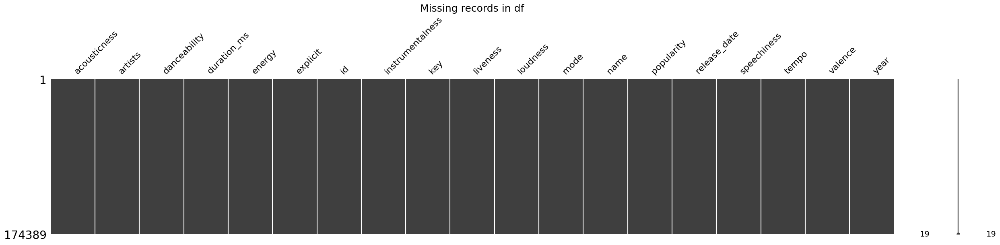

In [31]:
missingno.matrix(df, figsize = (30,5))
plt.title("Missing records in df", fontsize = '18')

Text(0.5, 1.0, 'Missing records in df_year')

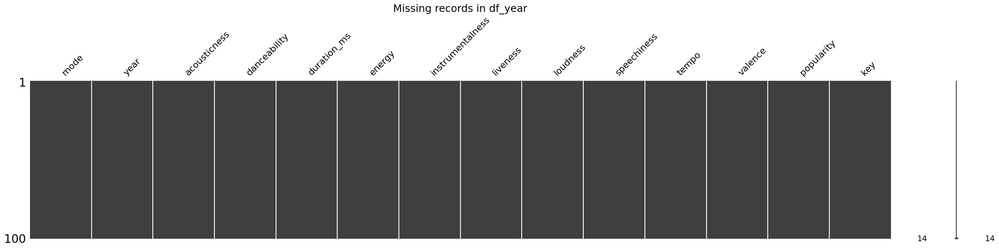

In [32]:
missingno.matrix(df_year, figsize = (30,5))
plt.title("Missing records in df_year", fontsize = '18')

Text(0.5, 1.0, 'Missing records in df_genre')

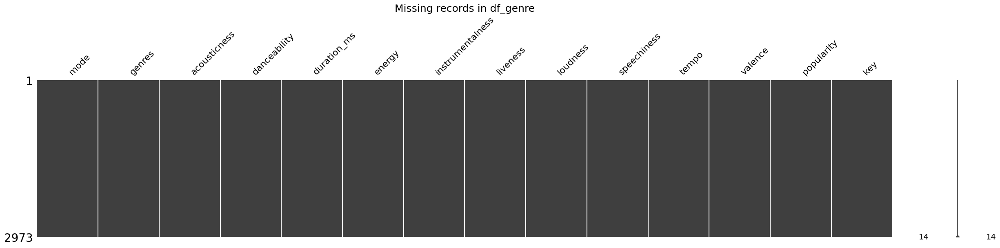

In [33]:
missingno.matrix(df_genre, figsize = (30,5))
plt.title("Missing records in df_genre", fontsize = '18')


Exploratory Data Analysis

In [34]:

year_count = df.groupby('year').size().reset_index()

year_count = year_count.rename(columns = {'index':'year', 0:'count'})

print("Columns before processing:", year_count.columns)
print("DataFrame head before processing:")
print(year_count.head())

year_count['year'] = year_count['year'].astype(str)

if 'year' in year_count.columns and 'count' in year_count.columns:
    try:

        year_count['year'] = pd.to_datetime(year_count['year'], format='%Y', errors='coerce')

        year_count.dropna(subset=['year'], inplace=True)

        year_count.sort_values(by=['year'], inplace = True)


        year_count_resampled = year_count.set_index('year')['count'].resample('10AS').sum().reset_index()

        print("Resampled DataFrame year_count_resampled:")
        print(year_count_resampled.head())
        print(year_count_resampled.columns)


        df_to_plot = year_count_resampled
        print("Processing after resampling successful. DataFrame for plotting has columns:", df_to_plot.columns.tolist())


    except Exception as e:
        print(f"An error occurred during datetime conversion or resampling: {e}")
        print("Using original year_count for plotting (without resampling).")
        df_to_plot = year_count
else:
    print("Error: 'year' or 'count' column not found in the input dataframe.")
    print("Cannot perform resampling as necessary columns are missing.")
    df_to_plot = pd.DataFrame(columns=['year', 'count']) # Assign an empty df to avoid NameError



if 'df_to_plot' in locals() and not df_to_plot.empty:
    df_to_plot['year_str'] = df_to_plot['year'].dt.year.astype(str)
    fig = px.bar(df_to_plot, x="year", y='count', title="NO. OF SONGS IN THE DATASET BY YEARS",
                     width=1000, height=500)
    fig.show(renderer="colab")
else:
    print("Plotting skipped because df_to_plot was not created or is empty.")

Columns before processing: Index(['year', 'count'], dtype='object')
DataFrame head before processing:
   year  count
0  1920    349
1  1921    156
2  1922    121
3  1923    185
4  1924    236
Resampled DataFrame year_count_resampled:
        year  count
0 1920-01-01   5631
1 1930-01-01  10764
2 1940-01-01  15493
3 1950-01-01  20000
4 1960-01-01  19610
Index(['year', 'count'], dtype='object')
Processing after resampling successful. DataFrame for plotting has columns: ['year', 'count']


In [35]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(df_year, x='year', y=sound_features, title="MUSIC PROFILE THROUGHOUT THE YEARS",
                 width=1000, height=500)
fig.add_vrect(x0=1966, x1=1966, line_width=1, line_color="red")

fig.show(renderer="colab")

In [36]:
top10_genres = df_genre.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group', title = 'TOP 10 GENRES AND THEIR MUSIC PROFILE COMPOSITION',
                 width=1000, height=500)
fig.show(renderer="colab")


In [37]:

numeric_df = df.select_dtypes(include=np.number)

df_corr = round(numeric_df.corr(), 2)

fig = px.imshow(df_corr, text_auto=True, title='CORRELATION HEATMAP (df)')
fig.update_layout(
    autosize=False,
    width=800,
    height=800
)
fig.show(renderer="colab")

PCA to Analyze Songs

In [38]:
chosen = ["energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
text1 = df["artists"] + " - " + df["name"]
text2 = text1.values

X = df[chosen].values
y = df["danceability"].values

scaler = MinMaxScaler()
X = scaler.fit_transform(X)

pca = PCA(n_components=3)
pca.fit(X)

X = pca.transform(X)


In [39]:
trace = go.Scatter3d(
    x=X[:,0],
    y=X[:,1],
    z=X[:,2],
    text=text2,
    mode="markers",
    marker=dict(
        size=8,
        color=y,
        colorbar=dict(
            title="Danceability"
        )
    )
)

fig = go.Figure(data=[trace])

fig.update_layout(
    title='WHICH SONGS ARE DANCEABLE?',
    autosize=False,
    width=1200,
    height=900,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title="Principal Component 1",
        yaxis_title="Principal Component 2",
        zaxis_title="Principal Component 3",
    ),
)

fig.show(renderer="colab")


In [40]:
df_genre=pd.read_csv('/content/data_by_genres.csv')
df_year=pd.read_csv('/content/data_by_year.csv')

In [41]:
df_genre.head(2)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.3616,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.1310,-16.854000,0.076817,120.285667,0.221750,52.500000,5


In [42]:
df_year.head(2)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.20571,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.24072,-19.275282,0.116655,100.884521,0.535549,0.140845,10


In [43]:
d_genre=df_genre[df_genre['genres'].str.contains('pop')]
print(d_genre.shape)

pop_track_indices = []
for index, row in df.iterrows():
    if 'genres' in row and isinstance(row['genres'], str):
         if any(genre in row['genres'] for genre in d_genre['genres'].unique()):
             pop_track_indices.append(index)

if pop_track_indices:

    pop_track_indices_tfidf_vectors = tfidf_matrix[pop_track_indices, :]

    pop_profile = np.mean(pop_track_indices_tfidf_vectors, axis=0).reshape(1, -1)

    pd.DataFrame(sorted(zip(tfidf_feature_names, pop_profile.flatten().tolist()), key=lambda x: -x[1])[:10],  # sort by value desc
                 columns=['token', 'relevance'])
else:

    print("No 'pop' tracks found based on the defined logic. Cannot calculate pop_profile.")

(298, 14)
No 'pop' tracks found based on the defined logic. Cannot calculate pop_profile.


APPLYING CONTENT BASED RERCOMMENDOR

In [44]:
def recommend_popular_songs(df, num_recommendations=10):

  if 'popularity' not in df.columns:
    print("Error: 'popularity' column not found in the DataFrame.")
    return pd.DataFrame()
  popular_songs = df.sort_values('popularity', ascending=False)

  return popular_songs.head(num_recommendations)

top_popular_songs = recommend_popular_songs(df, num_recommendations=10)

if not top_popular_songs.empty:
  print("Top 10 Most Popular Songs:")
  print(top_popular_songs[['name', 'artists', 'popularity']])


Top 10 Most Popular Songs:
                         name                       artists  popularity
20062         drivers license            ['Olivia Rodrigo']         100
19862  Mood (feat. iann dior)     ['24kGoldn', 'iann dior']          96
19866               positions             ['Ariana Grande']          96
19976                 BICHOTA                   ['KAROL G']          95
19886                  DÁKITI  ['Bad Bunny', 'Jhay Cortez']          95
19872             WITHOUT YOU             ['The Kid LAROI']          94
19928      LA NOCHE DE ANOCHE      ['Bad Bunny', 'ROSALÍA']          94
19876          Therefore I Am             ['Billie Eilish']          94
19870                 Whoopty                        ['CJ']          94
19868                   34+35             ['Ariana Grande']          94


In [45]:
def recommend_songs_by_year(df, year, num_recommendations=10):

  if 'year' not in df.columns or 'popularity' not in df.columns:
    print("Error: 'year' or 'popularity' column not found in the DataFrame.")
    return pd.DataFrame()
  songs_in_year = df[df['year'] == year]

  if songs_in_year.empty:
    print(f"No songs found for the year {year}.")
    return pd.DataFrame()
  recommended_songs = songs_in_year.sort_values('popularity', ascending=False)

  return recommended_songs.head(num_recommendations)


recommendations_2000 = recommend_songs_by_year(df, year=2000, num_recommendations=5)

if not recommendations_2000.empty:
  print("\nTop 5 Recommended Songs from 2000:")
  print(recommendations_2000[['name', 'artists', 'popularity', 'year']])

recommendations_1985 = recommend_songs_by_year(df, year=1985, num_recommendations=10)

if not recommendations_1985.empty:
  print("\nTop 10 Recommended Songs from 1985:")
  print(recommendations_1985[['name', 'artists', 'popularity', 'year']])


Top 5 Recommended Songs from 2000:
                      name           artists  popularity  year
15862               Yellow      ['Coldplay']          85  2000
15868           In the End   ['Linkin Park']          83  2000
15864          Ms. Jackson       ['Outkast']          80  2000
15870  The Real Slim Shady        ['Eminem']          79  2000
15866           Kryptonite  ['3 Doors Down']          78  2000

Top 10 Recommended Songs from 1985:
                                          name  \
12862  Just the Two of Us (feat. Bill Withers)   
12864                               Take on Me   
12863        Everybody Wants To Rule The World   
12867                      Walking On Sunshine   
12866                       We Built This City   
12868                         Eye of the Tiger   
12872                    Devuélveme a mi chica   
12865              Don't You (Forget About Me)   
12873        You Spin Me Round (Like a Record)   
12877                                Your Love   